In [1]:
import math
import pandas as pd
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from utils.tools import reduce_mem_usage
from utils.classes import PathSet


In [2]:
"""
TripID:
    * path: 
        [:-3],      date
        [-7:-3],    time
        [-3:],      od
"""

"""global parameters"""
df = pd.read_hdf('/home/pcl/Data/GBA/gba_db.h5')
path_set = PathSet(load=True, cache_folder='../cache', file_name='path_features')

gba_area = gpd.read_file("../db/gba_boundary.geojson")
bridges = gpd.read_file("../db/bridges.geojson")
gdf_paths = path_set.convert_to_gdf()
gdf_paths = gpd.sjoin(left_df=gdf_paths, right_df=bridges[['bridge', 'geometry']], op='intersects', how='left') 


cities_lst = ["Hong Kong","Macao","Guangzhou","Shenzhen","Zhuhai","Foshan","Huizhou","Dongguan","Zhongshan","Jiangmen","Zhaoqing"]


In [3]:
"""tool functions"""
# period split
def period_split(df):
    # 区间左闭右开
    period_bins = ['20190302 1200', '20190402 1150', '20200505 1350', '20200515 0850', '20211230 0900']
    period_bins = [ pd.to_datetime(x) for x in period_bins]
    period_labels = [ i+1 for i in range(len(period_bins)-1)]
    df.loc[:, 'period'] = pd.cut(df.time, period_bins, labels=period_labels)
    
    return df

# outlier filter
def outlier_filter(df, group_cols = ['OD', 'date'], col='speed', mul_factor=3):
    df_groups = df.groupby(group_cols)

    df_outlier_index = pd.concat([df_groups[col].mean(), df_groups[col].std()], axis=1)
    df_outlier_index.columns = ['_mean', '_std']
    df_outlier_index.loc[:, 'lower'] = df_outlier_index._mean - mul_factor * df_outlier_index._std
    df_outlier_index.loc[:, 'upper'] = df_outlier_index._mean + mul_factor * df_outlier_index._std
    df_outlier_index.reset_index(inplace=True)
    
    df_ = df.merge(df_outlier_index, on=group_cols).query("lower <= speed <= upper")[df.columns]
    df_.sort_values(by=['time', 'OD'], inplace=True)

    df_outliers = pd.concat([df, df_]).drop_duplicates(keep=False).sort_values(by=['time', 'OD'])
    print(f"outliers size: {df.shape[0]-df_.shape[0]}, percentage: {(1-df_.shape[0]/df.shape[0])*100:.2f}%")
    
    return df_, df_outliers

def add_df_info(df):
    pois = pd.read_excel("../db/cities_poi.xlsx",'poi').rename(columns={'id': 'OD'})
    reduce_mem_usage(pois)
    df = df.merge( pois[['OD', 'o', 'd']], on="OD")
    df.speed = df.speed.astype(np.float32)

    cities_order = ["Hong Kong","Macao","Guangzhou","Shenzhen","Zhuhai","Foshan","Huizhou","Dongguan","Zhongshan","Jiangmen","Zhaoqing"]
    for i in ["o", 'd']:
        df[i] = df[i].astype("category")
        df[i].cat.set_categories(cities_order, inplace=True)
        
    df.loc[:, 'dayofweek'] = df.time.dt.dayofweek
    holidays = ['20190404', '20190405'] # 特殊节假日
    df.loc[:, 'holiday'] = False
    df.loc[df.query(f"date in {holidays} ").index, 'holiday'] = True
    # df[df.period==2].groupby(['period','weekday','date'])['OD'].count()
    
    return df

def plot_trip(o='Shenzhen', d = 'Zhuhai', gdf_paths=gdf_paths):
    pids = paths.query(f" o == '{o}' and d == '{d}' ").fid_lst.values[0]
    pids = np.delete(pids, list(pids).index(-1))

    ax = gba_area.plot(figsize=(12,8))
    gdf_paths.loc[pids].plot(ax=ax, color='r')
    ax.set_title( f"{o} -> {d}" )
    
    return 



In [4]:
df = add_df_info(df)
df, df_outliers = outlier_filter(df, group_cols = ['OD', 'date'])
df_equal_weight = df.groupby(['o', 'd', 'time']).mean().dropna().reset_index()
print( f"df_equal_weight size shrink {df.shape[0]}->{df_equal_weight.shape[0]}, cut down {(1-df_equal_weight.shape[0]/df.shape[0])*100:.2f}%" )
df_equal_weight = period_split(df_equal_weight)
df = period_split(df)

df = df.merge( gdf_paths[['fid', 'shape', 'bridge']], on='fid', how='left')

# 增加拥堵系数
df = df.merge(df.groupby(['OD'])[['speed']].max().rename(columns={'speed': 'speed_max'}), on = "OD")
df.loc[:, 'ci'] = df.speed_max / df.speed

df.loc[:, 'holiday/weekend'] = (df.holiday) | (df.dayofweek >= 5)


outliers size: 3154, percentage: 0.10%
df_equal_weight size shrink 3044967->390375, cut down 87.18%


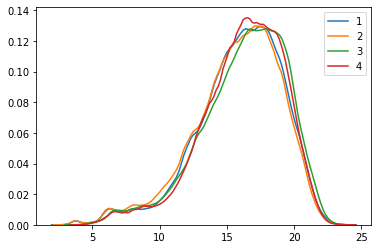

In [5]:
# 仅仅是速度分布曲线，看不出什么来
for i in range(1,5,1):
    sns.kdeplot(df.query(f"period == {i}").speed, label = i)

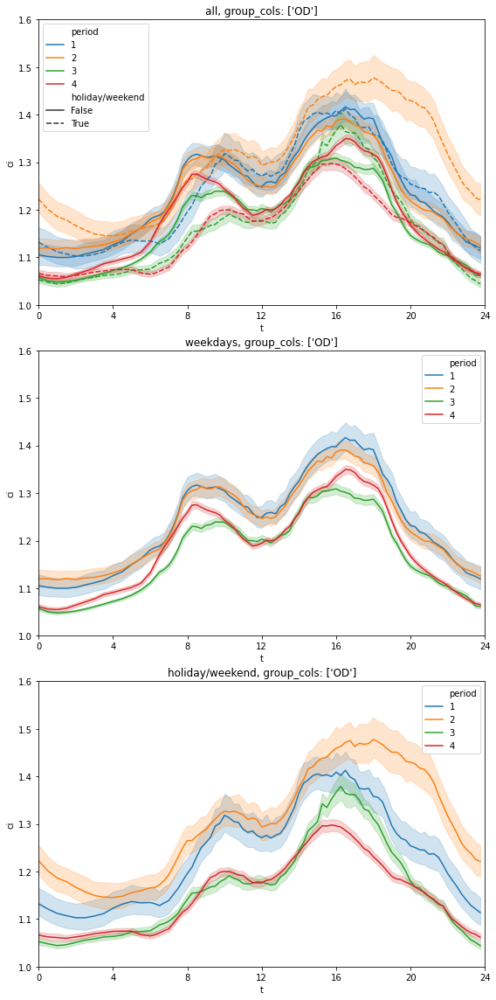

In [6]:
"""
The curves of congestion index of the whole net works in the four period:
    1: festival travel demand is too big for road capacity
    2: 虎门大桥的作用
TODO:
    1.受影响的出行
"""
def draw_curves_ci(df, holiday=True, group_cols=['OD'], sample=.1):
    df_ = df.copy()
    if holiday is not None:
        df_.query(f"dayofweek >=5 or holiday" if holiday else "dayofweek < 5 and not holiday", inplace=True)
    
    # df_speed = df_.groupby(group_cols)['speed'].mean().reset_index().dropna()
    df_speed = df_.merge(df_.groupby(['OD'])[['speed']].max().rename(columns={'speed': 'speed_max'}), on = "OD")
    
    df_speed.loc[:, 'ci'] = df_speed.speed_max / df_speed.speed
    # TODO 测试周五下午的情况
    df_speed.loc[:, 'holiday/weekend'] = (df_speed.holiday) | (df_speed.dayofweek >= 5)
    
    fig = plt.figure(figsize=(8, 16))
    ax = plt.subplot(3,1,1)    
    # http://seaborn.pydata.org/generated/seaborn.lineplot.html, confidence intervals
    sns.lineplot(x='t', y='ci', hue='period', style='holiday/weekend', data=df_speed, ax=ax  )
    ax.set_xlim(0, 24)
    ax.set_ylim(1, 1.6)
    ax.set_xticks(range(0, 28, 4))
    ax.set_title(f"all, group_cols: {group_cols}")
    
    ax = plt.subplot(3,1,2)    
    sns.lineplot(x='t', y='ci', hue='period', data=df_speed[~df_speed['holiday/weekend']], ax=ax  )
    ax.set_xlim(0, 24)
    ax.set_ylim(1, 1.6)
    ax.set_xticks(range(0, 28, 4))
    ax.set_title(f"weekdays, group_cols: {group_cols}")
    
    ax = plt.subplot(3,1,3)    
    sns.lineplot(x='t', y='ci', hue='period', dashes=False, data=df_speed[df_speed['holiday/weekend']], ax=ax  )
    ax.set_xlim(0, 24)
    ax.set_ylim(1, 1.6)
    ax.set_xticks(range(0, 28, 4))
    ax.set_title(f"holiday/weekend, group_cols: {group_cols}")
   
    plt.tight_layout(h_pad=.5)
    
    return fig

# _ = draw_curves_ci(df, holiday=None,  group_cols=['OD'])
_ = draw_curves_ci(df_equal_weight, holiday=None,  group_cols=['OD'])


In [6]:
def get_trip_related_to_bridges(df):
    tmp = df.groupby(['o', 'd', 'period','bridge'])[['OD']].count().reset_index()
    tmp_sum = tmp.groupby(['o', 'd', 'period']).sum().reset_index().rename(columns={'OD': '_sum'})
    tmp = tmp.merge(tmp_sum,  on=['o', 'd', 'period'] )   
    tmp.loc[:, 'percentage'] = tmp.OD / tmp._sum

    tmp = pd.pivot_table(tmp, values='percentage', aggfunc=np.mean, fill_value=np.nan, index=['o', 'd'], columns=['bridge','period']) 
    
    return tmp

# 50% 城市之间的出行组合和这三座桥有关联
df_od_related_to_bridges = get_trip_related_to_bridges(df)
df_od_related_to_bridges

bridge                   HZMB                          Humen bridge            \
period                      1         2         3    4            1         2   
o         d                                                                     
Hong Kong Macao      1.000000  1.000000  1.000000  1.0          NaN       NaN   
          Guangzhou       NaN       NaN       NaN  NaN     1.000000  0.250779   
          Zhuhai     1.000000  1.000000  1.000000  1.0          NaN       NaN   
          Foshan          NaN       NaN       NaN  NaN     1.000000  0.001245   
          Zhongshan  1.000000  1.000000  1.000000  1.0          NaN       NaN   
          Jiangmen   1.000000  1.000000  1.000000  1.0          NaN       NaN   
          Zhaoqing   0.666179  0.000831       NaN  NaN     0.333821  0.000416   
Macao     Hong Kong  1.000000  1.000000  1.000000  1.0          NaN       NaN   
          Shenzhen        NaN       NaN       NaN  NaN     1.000000  1.000000   
          Huizhou         NaN       NaN       NaN  NaN     1.000000  1.000000   
          Dongguan        NaN       NaN       NaN  NaN     1.000000  1.000000   
Guangzhou Hong Kong       NaN       NaN       NaN  NaN     1.000000  0.250624   
          Shenzhen        NaN       NaN       NaN  NaN     1.000000  0.667134   
          Huizhou         NaN       NaN       NaN  NaN     1.000000  1.000000   
          Dongguan        NaN       NaN       NaN  NaN     1.000000  0.673317   
Shenzhen  Macao           NaN       NaN       NaN  NaN     1.000000  1.000000   
          Guangzhou       NaN       NaN       NaN  NaN     1.000000  0.667185   
          Zhuhai          NaN       NaN       NaN  NaN     1.000000  1.000000   
          Foshan          NaN       NaN       NaN  NaN     1.000000  0.001659   
          Zhongshan       NaN       NaN       NaN  NaN     1.000000  1.000000   
          Jiangmen        NaN       NaN       NaN  NaN     1.000000  1.000000   
          Zhaoqing        NaN       NaN       NaN  NaN     1.000000  0.001662   
Zhuhai    Hong Kong  1.000000  1.000000  1.000000  1.0          NaN       NaN   
          Shenzhen        NaN       NaN       NaN  NaN     1.000000  1.000000   
          Huizhou         NaN       NaN       NaN  NaN     1.000000  1.000000   
          Dongguan        NaN       NaN       NaN  NaN     1.000000  1.000000   
Foshan    Hong Kong       NaN       NaN       NaN  NaN     1.000000  0.001244   
          Shenzhen        NaN       NaN       NaN  NaN     1.000000  0.083806   
          Huizhou         NaN       NaN       NaN  NaN     1.000000  0.736318   
          Dongguan        NaN       NaN       NaN  NaN          NaN       NaN   
Huizhou   Macao           NaN       NaN       NaN  NaN     1.000000  1.000000   
          Guangzhou       NaN       NaN       NaN  NaN     1.000000  1.000000   
          Zhuhai          NaN       NaN       NaN  NaN     1.000000  1.000000   
          Foshan          NaN       NaN       NaN  NaN     1.000000       NaN   
          Zhongshan       NaN       NaN       NaN  NaN     1.000000  1.000000   
          Jiangmen        NaN       NaN       NaN  NaN     1.000000  1.000000   
          Zhaoqing        NaN       NaN       NaN  NaN          NaN       NaN   
Dongguan  Macao           NaN       NaN       NaN  NaN     1.000000  1.000000   
          Guangzhou       NaN       NaN       NaN  NaN     1.000000  1.000000   
          Zhuhai          NaN       NaN       NaN  NaN     1.000000  1.000000   
          Foshan          NaN       NaN       NaN  NaN          NaN       NaN   
          Zhongshan       NaN       NaN       NaN  NaN     1.000000  1.000000   
          Jiangmen        NaN       NaN       NaN  NaN     1.000000  1.000000   
          Zhaoqing        NaN       NaN       NaN  NaN          NaN       NaN   
Zhongshan Hong Kong  0.666667  0.667774  0.666512  NaN     0.333333  0.332226   
          Shenzhen        NaN       NaN       NaN  NaN     1.000000  1.000000   
          Huizhou         NaN  

In [7]:
od_related_to_bridge = pd.DataFrame(df_od_related_to_bridges.index, columns=['OD'])
od_related_to_bridge.loc[:, 'o'] = od_related_to_bridge.OD.apply(lambda x: x[0])
od_related_to_bridge.loc[:, 'd'] = od_related_to_bridge.OD.apply(lambda x: x[1])
df_related_to_bridges = df.merge(od_related_to_bridge[['o', 'd']], on=['o', 'd'])


In [50]:
df_equal_weight_2 = df_related_to_bridges.groupby(['o', 'd', 'time']).mean().dropna().reset_index()
print( f"df_equal_weight size shrink {df.shape[0]}->{df_equal_weight.shape[0]}, cut down {(1-df_equal_weight.shape[0]/df.shape[0])*100:.2f}%" )
df_equal_weight_2 = period_split(df_equal_weight_2)

_ = draw_curves_ci(df_equal_weight_2, holiday=None,  group_cols=['OD'])


df_equal_weight size shrink 3044967->390375, cut down 87.18%


AttributeError: 'DataFrame' object has no attribute 'speed_max'

In [16]:
dates = df.date.unique()
dates.sort()

date = dates[0]
city = cities_lst[0]

dist_cols = len(cities_lst)
dist_rows = len(dates)
fig = plt.figure(figsize=(6*dist_cols, 4*dist_rows))

i = 0
for date in dates:
    for o in cities_lst:
        print(date, o)
        data = df.query( f" date =={date} and o =='{o}' " )
        ax = plt.subplot(dist_rows, dist_cols, i+1)
        tag = data.holiday.unique()[0] or (data.dayofweek >=5).unique()[0]
        if tag:
            sns.lineplot( x='t', y='speed', color='orange', data=data)
        else:
            sns.lineplot( x='t', y='speed', data=data)
            
        _mean = data.speed.mean()
        ax.hlines(_mean, 0, 24, colors='gray', linestyles ='dotted', label=f"{_mean:.1f}, {data.speed.std():.1f}", )
        ax.set_xlim(0, 24)
        ax.set_xlabel(o)
        ax.set_ylabel(str(date))
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()


20190322 Hong Kong
20190322 Macao
20190322 Guangzhou
20190322 Shenzhen
20190322 Zhuhai
20190322 Foshan
20190322 Huizhou
20190322 Dongguan
20190322 Zhongshan
20190322 Jiangmen
20190322 Zhaoqing
20190323 Hong Kong
20190323 Macao
20190323 Guangzhou
20190323 Shenzhen
20190323 Zhuhai
20190323 Foshan
20190323 Huizhou
20190323 Dongguan
20190323 Zhongshan
20190323 Jiangmen
20190323 Zhaoqing
20190324 Hong Kong
20190324 Macao
20190324 Guangzhou
20190324 Shenzhen
20190324 Zhuhai
20190324 Foshan
20190324 Huizhou
20190324 Dongguan
20190324 Zhongshan
20190324 Jiangmen
20190324 Zhaoqing
20190325 Hong Kong
20190325 Macao
20190325 Guangzhou
20190325 Shenzhen
20190325 Zhuhai
20190325 Foshan
20190325 Huizhou
20190325 Dongguan
20190325 Zhongshan
20190325 Jiangmen
20190325 Zhaoqing
20190326 Hong Kong
20190326 Macao
20190326 Guangzhou
20190326 Shenzhen
20190326 Zhuhai
20190326 Foshan
20190326 Huizhou
20190326 Dongguan
20190326 Zhongshan
20190326 Jiangmen
20190326 Zhaoqing
20190327 Hong Kong
20190327 Macao
2

20200527 Foshan
20200527 Huizhou
20200527 Dongguan
20200527 Zhongshan
20200527 Jiangmen
20200527 Zhaoqing
20200528 Hong Kong
20200528 Macao
20200528 Guangzhou
20200528 Shenzhen
20200528 Zhuhai
20200528 Foshan
20200528 Huizhou
20200528 Dongguan
20200528 Zhongshan
20200528 Jiangmen
20200528 Zhaoqing
20200529 Hong Kong
20200529 Macao
20200529 Guangzhou
20200529 Shenzhen
20200529 Zhuhai
20200529 Foshan
20200529 Huizhou
20200529 Dongguan
20200529 Zhongshan
20200529 Jiangmen
20200529 Zhaoqing
20200530 Hong Kong
20200530 Macao
20200530 Guangzhou
20200530 Shenzhen
20200530 Zhuhai
20200530 Foshan
20200530 Huizhou
20200530 Dongguan
20200530 Zhongshan
20200530 Jiangmen
20200530 Zhaoqing
20200531 Hong Kong
20200531 Macao
20200531 Guangzhou
20200531 Shenzhen
20200531 Zhuhai
20200531 Foshan
20200531 Huizhou
20200531 Dongguan
20200531 Zhongshan
20200531 Jiangmen
20200531 Zhaoqing
20200601 Hong Kong
20200601 Macao
20200601 Guangzhou
20200601 Shenzhen
20200601 Zhuhai
20200601 Foshan
20200601 Huizhou
20

In [18]:
fig.savefig('./test_dis.jpg', dpi=110)

In [36]:
def draw_speed_distribution_of_11_cities(df, key='ci', test=False):
    dates = df.date.unique()
    dates.sort()
    if test:
        dates = dates[:2]
    
    dist_cols, dist_rows = len(cities_lst), len(dates)
    fig = plt.figure(figsize=(6*dist_cols, 4*dist_rows))

    i = 0
    for date_index, date in tqdm(enumerate(dates)):
        for o in cities_lst:
            data = df.query( f" date =={date} and o =='{o}' " )
            ax = plt.subplot(dist_rows, dist_cols, i+1)
            tag = data.holiday.unique()[0] or (data.dayofweek >=5).unique()[0]
            if tag:
                sns.lineplot( x='t', y=key, color='orange', data=data)
            else:
                sns.lineplot( x='t', y=key, data=data)
                
            _mean = data[key].mean()
            ax.hlines(_mean, 0, 24, colors='gray', linestyles ='dotted', label=f"{_mean:.2f}, {data.speed.std():.2f}", )
            ax.set_xlim(0, 24)
            ax.set_xticks(range(0, 25, 6))
            ax.set_xlabel(o)
            ax.set_ylabel(str(date))
            ax.legend()
            i += 1

    plt.tight_layout()
    plt.show()
    
    return fig

# fig = draw_speed_distribution_of_11_cities(df, 'ci')

In [39]:
fig = draw_speed_distribution_of_11_cities(df, 'ci',test=False)
fig.savefig('../result/11座城市50天拥堵系数分布曲线.jpg', dpi=120)

50it [20:03, 24.07s/it]


In [15]:
fig = draw_speed_distribution_of_11_cities(df_related_to_bridges, 'ci',test=False)
fig.savefig('../result/11座城市50天拥堵系数分布曲线_仅考虑和桥相关的出行.jpg', dpi=120)

NameError: name 'draw_speed_distribution_of_11_cities' is not defined

11it [15:52, 86.57s/it]


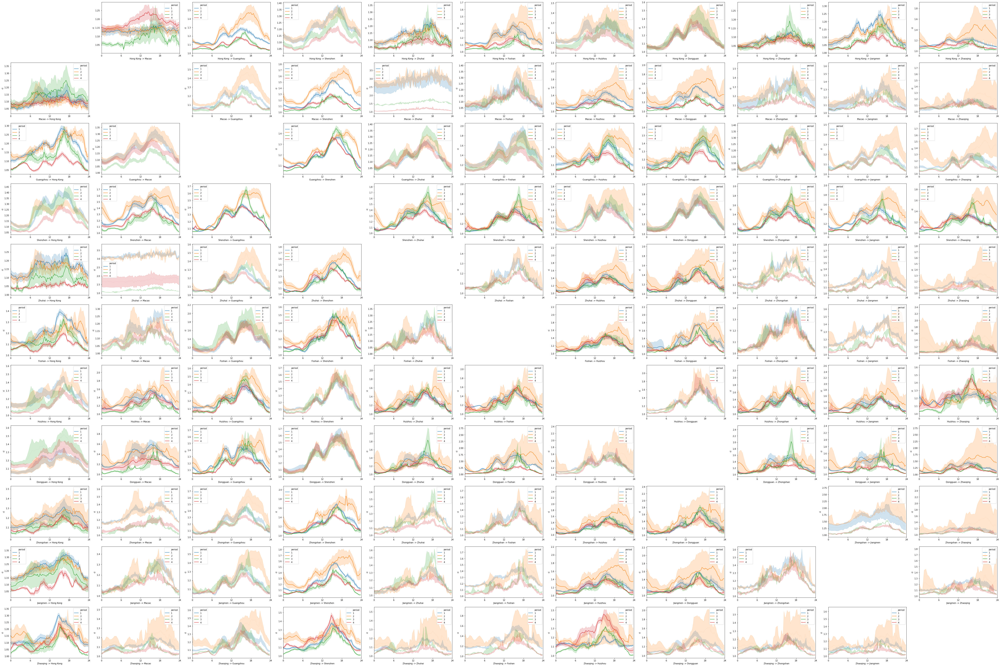

In [16]:
import copy

def dict_to_sql_sentence(con):
    condition = copy.deepcopy(con)
    for key, val in condition.items():
        if isinstance(val, str):
            condition[key] = f"'{val}'"
    
    sql = " and ".join( [ f"{key} == { val if isinstance(val, str) else val }"  for key, val in condition.items()])
    
    return sql    

def draw_lines(df, df_all, key = 'speed', sql=None, *args, **kwargs):
    data = df.query(sql) if sql is not None else df.copy()
    flag = False
    
    if data.shape[0] == 0:
        data = df_all.query(sql) if sql is not None else df.copy()
        kwargs['alpha'] = .05
        flag = True
        
    ax = sns.lineplot(x='t', y=key, data=data, *args, **kwargs)
    ax.set_xlim(0, 24)
    ax.set_xticks(range(0, 25, 6))
    if flag:
        ax.set_alpha(.5)
        
    return ax

def draw_gba_intercities_index(df, df_all, holiday_or_weekend, key='ci', test=False, verbose=False, *args, **kwargs):
    dist_cols = dist_rows = len(cities_lst)

    fig = plt.figure(figsize=(6*dist_cols, 4*dist_rows))
    for i, o in tqdm(enumerate(cities_lst[3:4] if test else cities_lst)):
        for j, d in enumerate(cities_lst):
            if o == d:
                continue
            
            ax = plt.subplot(dist_rows, dist_cols, i*dist_cols+j+1, )
            con = {
                'o': o,
                'd': d,
                '`holiday/weekend`': holiday_or_weekend
            }
            sql = dict_to_sql_sentence(con)
            if verbose: print(sql)
            ax = draw_lines(df, df_all, key, sql, hue='period')

            if ax is None:
                continue
            ax.set_xlabel(f"{o} -> {d}")

    plt.tight_layout()
    plt.show()
    
    return fig

fig = draw_gba_intercities_index(df_related_to_bridges, df, holiday_or_weekend=True, test=False, verbose=False)
fig.savefig('../result/speed_distibution_bew_cities_under_4_period_in_holiday.pdf')

11it [17:34, 95.86s/it]


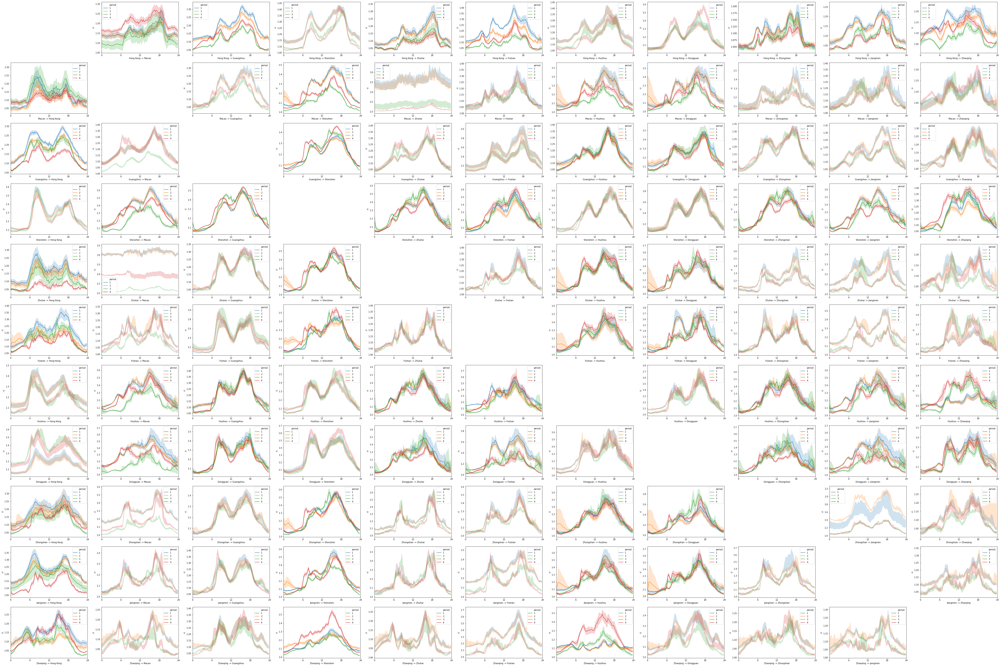

In [17]:
fig = draw_gba_intercities_index(df_related_to_bridges, df, holiday_or_weekend=False, test=False, verbose=False)
fig.savefig('../result/speed_distibution_bew_cities_under_4_period_in_weekday.pdf')